In [33]:
# Reading libraries
import tensorflow as tf # neural net base library
import pandas as pd # for dataset manipulation
import numpy as np # array manipulation
from glob import glob # Used to retrieve files/pathnames matching a specified pattern
from PIL import Image # This library provides powerful image processing and graphics capabilities
import cv2 # library of Python bindings designed to solve computer vision problems
import os # OS module in python provides functions for interacting with the operating system
import matplotlib.pyplot as plt # Python plotting library
import matplotlib.patches as patches # for the boxes over images
import seaborn as sns #high level wrapper for matplotlib, I have used plotly
import plotly as py # interactive graphing library
import plotly.io as pio 
from plotly import graph_objects as go
pio.renderers.default = "notebook_connected" # to display the graphs in the notebook itself

For plotly graphs refer to plotly git repo here: https://github.com/alphadatagamma/Plotly-dashboarding

In [2]:
#os.getcwd()
# Setting path for where the train and test data resides
train_dir = ".\\data\\train\\"
test_dir = ".\\data\\test\\"

In [27]:
# Finding the number of train and test images
train_fns = glob(train_dir + '*') # list with all filenames/pathnames of train images
test_fns = glob(test_dir + '*') # list with all filenames/pathnames of train images

print('Number of train images is {}'.format(len(train_fns)))
print('Number of test images is {}'.format(len(test_fns)))

Number of train images is 3422
Number of test images is 10


In [37]:
'''Just 3422 images for the training seems to be not much at all. 
Data augmentation techniques will be definetely required in this competition.'''

# Reading the train data, whcih contains image id and bbox which is a list with 4 elements: x coordinate, y coordinate, 
    # width and height

train = pd.read_csv(".\\data\\train.csv")

print(train.image_id.unique().shape)

train


(3373,)


,image_id,width,height,bbox,source
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1
...,...,...,...,...,...
147788,5e0747034,1024,1024,"[64.0, 619.0, 84.0, 95.0]",arvalis_2
147789,5e0747034,1024,1024,"[292.0, 549.0, 107.0, 82.0]",arvalis_2
147790,5e0747034,1024,1024,"[134.0, 228.0, 141.0, 71.0]",arvalis_2
147791,5e0747034,1024,1024,"[430.0, 13.0, 184.0, 79.0]",arvalis_2


#### We have 3422 images, but in the train with boxes we just have 3373 images, meaning there are 49 images which do not have boxes in them

In [41]:
# Verifying
print('{} images without wheat heads.'.format(len(all_train_images) - len(train)))

49 images without wheat heads.


In [6]:
# Create a dataframe with all train images' id's
all_train_images = pd.DataFrame([fns.split('\\')[-1][0:-4]for fns in train_fns])
all_train_images.columns=['image_id']
all_train_images

,image_id
0,00333207f
1,005b0d8bb
2,006a994f7
3,00764ad5d
4,00b5c6764
...,...
3417,ffbb9c623
3418,ffbf75e5b
3419,ffbfe7cc0
3420,ffc870198


In [7]:
# Merge all train images with the bounding boxes dataframe, to get details against images which have boxes
all_train_images = all_train_images.merge(train, on='image_id', how='left')
all_train_images

,image_id,width,height,bbox,source
0,00333207f,1024.0,1024.0,"[0, 654, 37, 111]",arvalis_1
1,00333207f,1024.0,1024.0,"[0, 817, 135, 98]",arvalis_1
2,00333207f,1024.0,1024.0,"[0, 192, 22, 81]",arvalis_1
3,00333207f,1024.0,1024.0,"[4, 342, 63, 38]",arvalis_1
4,00333207f,1024.0,1024.0,"[82, 334, 82, 81]",arvalis_1
...,...,...,...,...,...
147837,ffdf83e42,1024.0,1024.0,"[946.0, 419.0, 74.0, 69.0]",arvalis_1
147838,ffdf83e42,1024.0,1024.0,"[897.0, 647.0, 59.0, 56.0]",arvalis_1
147839,ffdf83e42,1024.0,1024.0,"[490.0, 912.0, 62.0, 81.0]",arvalis_1
147840,ffdf83e42,1024.0,1024.0,"[179.0, 343.0, 66.0, 96.0]",arvalis_1


### Cool the data looks fine

In [40]:
# splitting bbox column to separate the attributes(x,y, width, height)
bbox_items = all_train_images.bbox.str.split(',', expand=True)
all_train_images['bbox_xmin'] = bbox_items[0].str.strip('[ ').astype(float)
all_train_images['bbox_ymin'] = bbox_items[1].str.strip(' ').astype(float)
all_train_images['bbox_width'] = bbox_items[2].str.strip(' ').astype(float)
all_train_images['bbox_height'] = bbox_items[3].str.strip(' ]').astype(float)
all_train_images

,image_id,width,height,bbox,source,bbox_xmin,bbox_ymin,bbox_width,bbox_height,count,bbox_area,brightness
0,00333207f,1024.0,1024.0,"[0, 654, 37, 111]",arvalis_1,0.0,654.0,37.0,111.0,1,4107.0,131.098916
1,00333207f,1024.0,1024.0,"[0, 817, 135, 98]",arvalis_1,0.0,817.0,135.0,98.0,1,13230.0,131.098916
2,00333207f,1024.0,1024.0,"[0, 192, 22, 81]",arvalis_1,0.0,192.0,22.0,81.0,1,1782.0,131.098916
3,00333207f,1024.0,1024.0,"[4, 342, 63, 38]",arvalis_1,4.0,342.0,63.0,38.0,1,2394.0,131.098916
4,00333207f,1024.0,1024.0,"[82, 334, 82, 81]",arvalis_1,82.0,334.0,82.0,81.0,1,6642.0,131.098916
...,...,...,...,...,...,...,...,...,...,...,...,...
147837,ffdf83e42,1024.0,1024.0,"[946.0, 419.0, 74.0, 69.0]",arvalis_1,946.0,419.0,74.0,69.0,1,5106.0,108.653064
147838,ffdf83e42,1024.0,1024.0,"[897.0, 647.0, 59.0, 56.0]",arvalis_1,897.0,647.0,59.0,56.0,1,3304.0,108.653064
147839,ffdf83e42,1024.0,1024.0,"[490.0, 912.0, 62.0, 81.0]",arvalis_1,490.0,912.0,62.0,81.0,1,5022.0,108.653064
147840,ffdf83e42,1024.0,1024.0,"[179.0, 343.0, 66.0, 96.0]",arvalis_1,179.0,343.0,66.0,96.0,1,6336.0,108.653064


### Function time

In [55]:
### Get_all_boxes : 
'''This function gets the attriutes of all the boxes corresponding to the image passed in the function. This has two inputs
the first being the dataset which contains the boxes info for all images, and the second being Image_id for whcih you need 
to extract the info'''

'''Also, this function uses rowwise iterations, which is something new and worth reading'''
def get_all_bboxes(df, image_id):
    image_bboxes = df[df.image_id == image_id]
    
    bboxes = []
    for _,row in image_bboxes.iterrows():
        bboxes.append((row.bbox_xmin, row.bbox_ymin, row.bbox_width, row.bbox_height))
        
    return bboxes


### plot_image_examples:
'''This function randommly selects n images from the dataset, created n subplots and then plots the images with boxes 
on them. It uses the function Get_all_boxes to get the attriutes of all the boxes corresponding to the image randomly 
selected'''
def plot_image_examples(df, n , title='Image examples'):
    rows= n
    cols= n
    fig, axs = plt.subplots(rows, cols, figsize=(12,12))
    for row in range(rows):
        for col in range(cols):
            idx = np.random.randint(len(df), size=1)[0]
            img_id = df.iloc[idx].image_id
            
            img = Image.open(train_dir + img_id + '.jpg')
            axs[row, col].imshow(img)
            
            bboxes = get_all_bboxes(df, img_id)
            
            for bbox in bboxes:
                rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],linewidth=1,edgecolor='r',facecolor='none')
                axs[row, col].add_patch(rect)
            
            axs[row, col].axis('off')
            
    plt.suptitle(title)

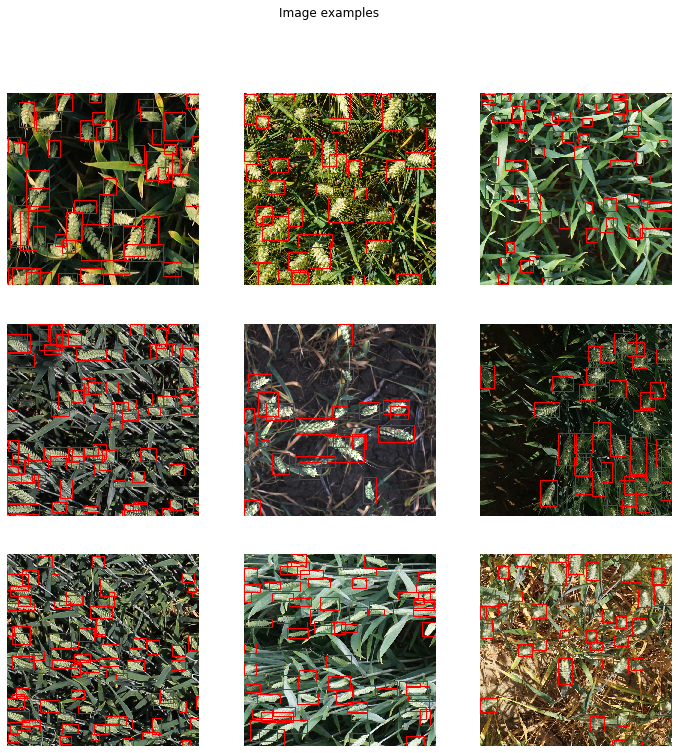

In [56]:
plot_image_examples(all_train_images, 3)

In [13]:
#get_all_bboxes(all_train_images,'00333207f' )

In [59]:
# Compute the number of bounding boxes per train image, I want to see thee distribution of number of heads per image

all_train_images['box_count'] = all_train_images.apply(lambda row: 1 if np.isfinite(row.width) else 0, axis=1)
train_images_box_count = all_train_images.groupby('image_id')['box_count'].sum().reset_index()

In [60]:
train_images_box_count

,image_id,box_count
0,00333207f,55
1,005b0d8bb,20
2,006a994f7,25
3,00764ad5d,41
4,00b5c6764,0
...,...,...
3417,ffbb9c623,0
3418,ffbf75e5b,52
3419,ffbfe7cc0,34
3420,ffc870198,41


In [61]:
## Using plotly to plot - see documentation at git link- https://github.com/alphadatagamma/Plotly-dashboarding
fig = go.Figure(data=[go.Histogram(x=train_images_count['box_count'])])
fig.show()

### This looks like a normal distribution
0 is the images without any boxes, and the graph has a tail on the right, 
meaning there are some boxes with ridiculously large number of boxes or wheatheads

### Lets see a few images with less boxes

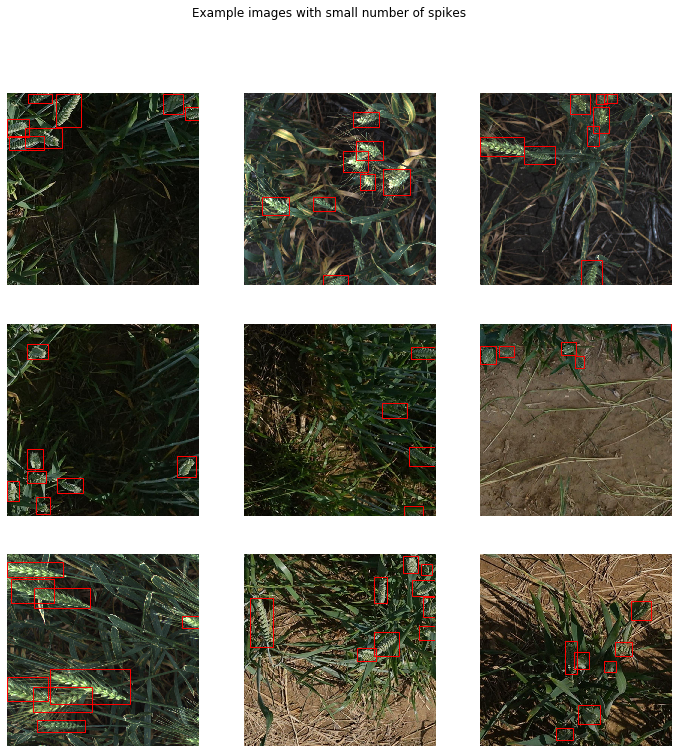

In [66]:
less_spikes_ids = train_images_count[train_images_count['box_count'] < 10].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(less_spikes_ids)],3, title='Example images with small number of spikes')

### Lets see images with a lot of boxes

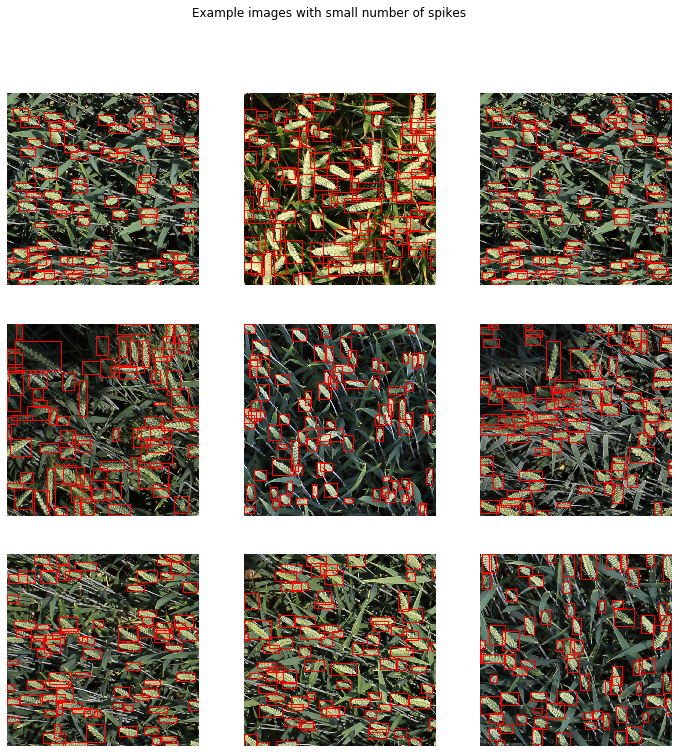

In [68]:
more_spikes_ids = train_images_count[train_images_count['box_count'] > 70].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(more_spikes_ids)],3, title='Example images with small number of spikes')

In [19]:
# compute bounding box areas
all_train_images['bbox_area'] = all_train_images['bbox_width'] * all_train_images['bbox_height']
fig = go.Figure(data=[go.Histogram(x=all_train_images['bbox_area'])])
fig.show()

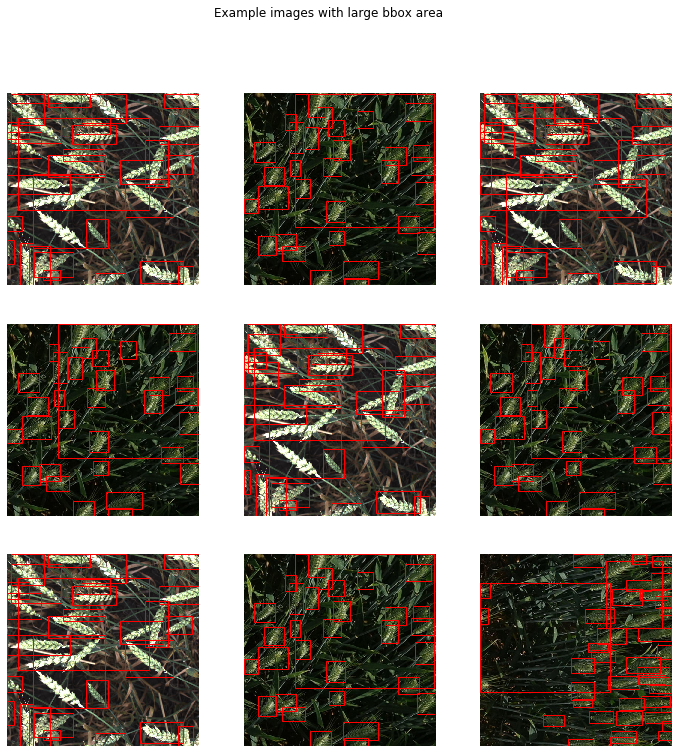

In [74]:
# Plotting images with large boxes
large_boxes_ids = all_train_images[all_train_images['bbox_area'] > 300000].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(large_boxes_ids)],3, title='Example images with large bbox area')

## Doesn't make sense to incluse such large boxes in model

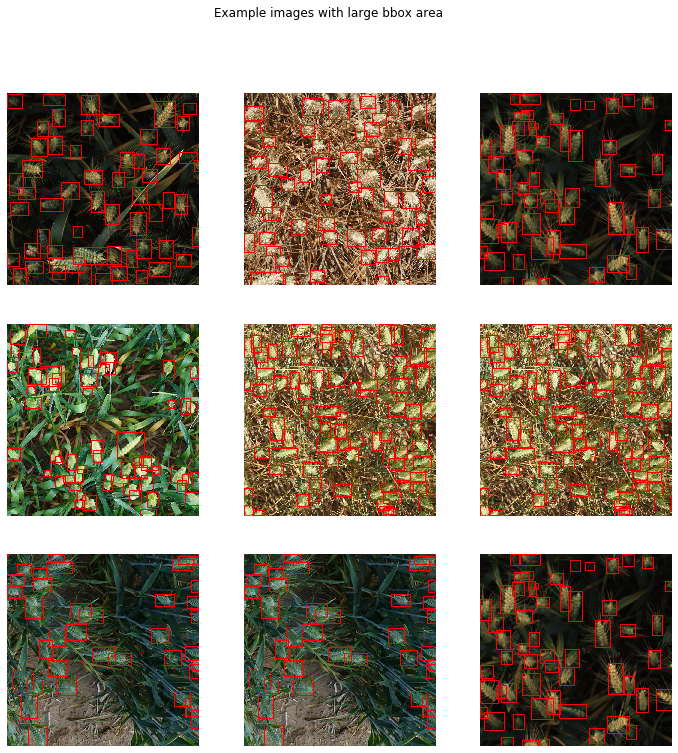

In [75]:
# Plotting images with small images
small_boxes_ids = all_train_images[(all_train_images['bbox_area'] < 25) & (all_train_images['bbox_area'] > 0)].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(small_boxes_ids)],3, title='Example images with large bbox area')

In [77]:
# Compute the total bounding boxes area per image. Why? 
'''To check what portion of image is generally covered with wheatheads or boxes'''

area_per_image = all_train_images.groupby(by='image_id')['bbox_area'].sum().reset_index()

# compute the percentage of the image area covered by bounding boxes
area_per_image_percentage = area_per_image.copy()
area_per_image_percentage['bbox_area'] = area_per_image_percentage['bbox_area'] / (1024*1024) * 100

In [78]:
fig = go.Figure(data=[go.Histogram(x=area_per_image_percentage['bbox_area'])])
fig.show()

This looks like a nice normal distribution! 20-40% of the image area is covered by the bounding boxes.

**This observation can be used to validate the predictions of the resulting model. The percentage of predicted bounding boxes area should be normally distributed too.**

We can also see that the maximum is actually greater than 100%. This means that the bounding boxes are overlapping.

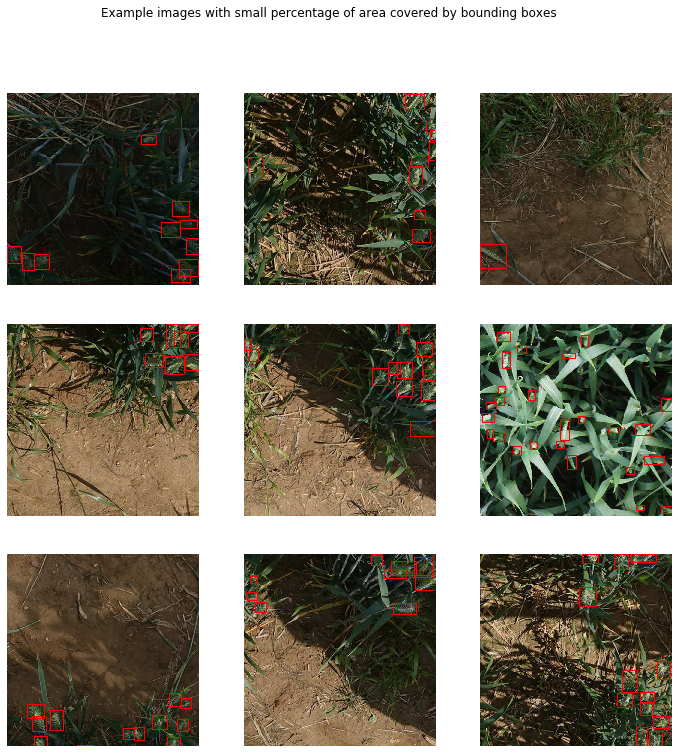

In [82]:
## Images with smaller area covered with boxes, are also images with lesser boxes or smaller boxes
small_area_perc_ids = area_per_image_percentage[area_per_image_percentage['bbox_area'] < 7].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(small_area_perc_ids)], 3, title='Example images with small percentage of area covered by bounding boxes')

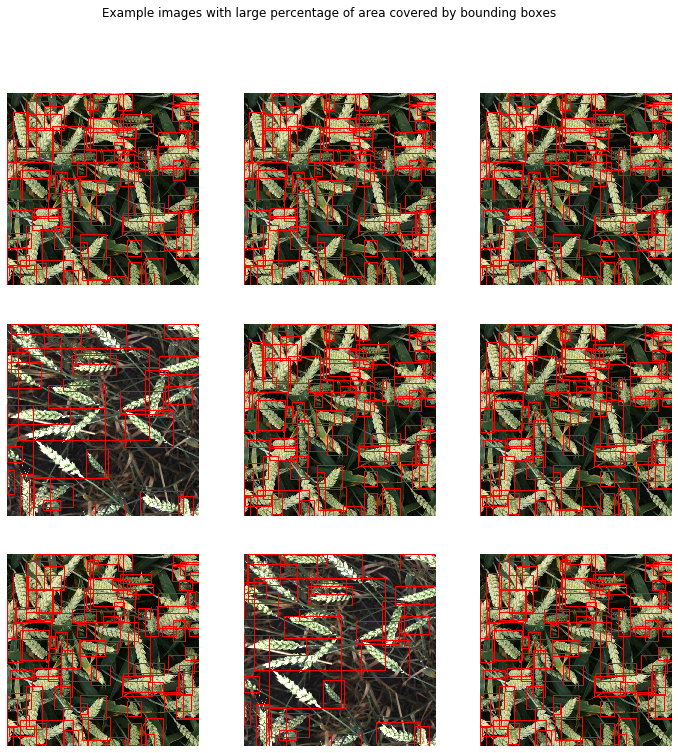

In [84]:
## Images with larger area covered with boxes, are also images with either more boxes or bigger boxes
large_area_perc_ids = area_per_image_percentage[area_per_image_percentage['bbox_area'] > 95].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(large_area_perc_ids)], 3, title='Example images with large percentage of area covered by bounding boxes')


In [89]:
## Getting brightness for the image
def get_image_brightness(image):
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # get average brightness
    return np.array(gray).mean()

# Adding brightness column to the dataframe, and calculating brightness value using the get_image_brightness function
def add_brightness(df):
    brightness = []
    
    for _, row in df.iterrows():
        img_id = row.image_id  
        image = cv2.imread(train_dir + img_id + '.jpg')
        brightness.append(get_image_brightness(image))
        
    brightness_df = pd.DataFrame(brightness)
    brightness_df.columns = ['brightness']
    df = pd.concat([df, brightness_df], ignore_index=True, axis=1)
    df.columns = ['image_id', 'brightness']
    
    return df

In [91]:
# Gettin all unique images' ids'
images_df = pd.DataFrame(all_train_images.image_id.unique())
images_df.columns = ['image_id']

In [92]:
# add brightness to the dataframe
images_df = pd.DataFrame(all_train_images.image_id.unique())
images_df.columns = ['image_id']
brightness_df = add_brightness(images_df)

all_train_images = all_train_images.merge(brightness_df, on='image_id')


In [93]:
fig = go.Figure(data=[go.Histogram(x=all_train_images['brightness'])])
fig.show()

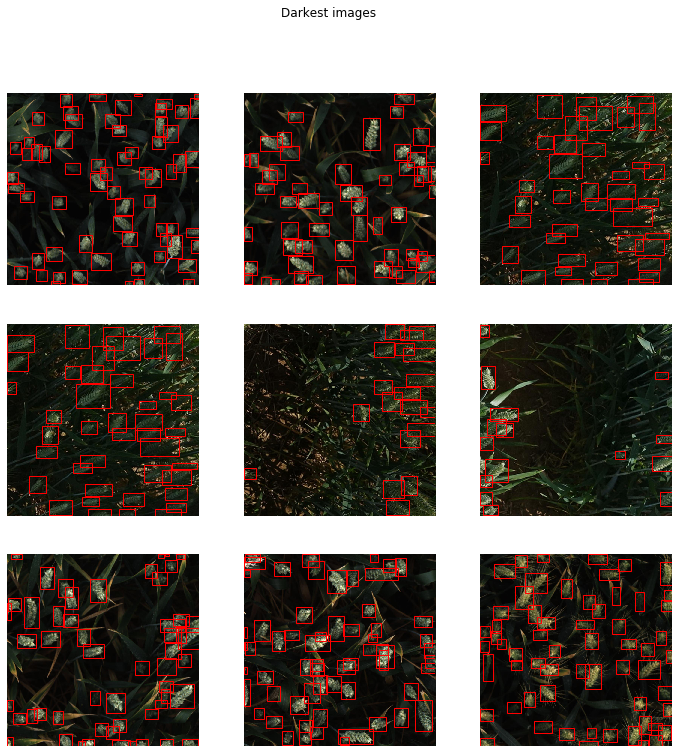

In [95]:
## Plotting the dark images
dark_ids = all_train_images[all_train_images['brightness'] < 30].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(dark_ids)],3, title='Darkest images')

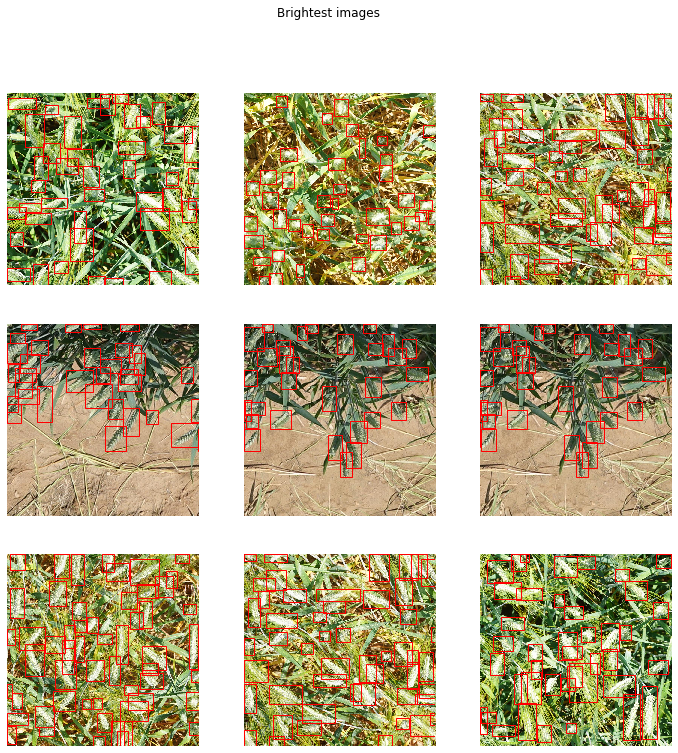

In [97]:
# plotting the bright images
bright_ids = all_train_images[all_train_images['brightness'] > 130].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(bright_ids)],3, title='Brightest images')

### I would like to plot images with different dominant colors. The idea is that the most green images will represent healthy plants. The most yellow images will contain plants close to maturity. The most brown images will have ground on them.

In [100]:
## Function to count the number of pixels in green range
def get_percentage_of_green_pixels(image):
    # convert to HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # get the green mask
    hsv_lower = (40, 40, 40) 
    hsv_higher = (70, 255, 255)
    green_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
    
    return float(np.sum(green_mask)) / 255 / (1024 * 1024)

## Function to count the number of pixels in yellow range
def get_percentage_of_yellow_pixels(image):
    # convert to HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # get the green mask
    hsv_lower = (25, 40, 40) 
    hsv_higher = (35, 255, 255)
    yellow_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
    
    return float(np.sum(yellow_mask)) / 255 / (1024 * 1024)

## Function to add the percentage of  pixels in green range
def add_green_pixels_percentage(df):
    green = []
    for _, row in df.iterrows():
        img_id = row.image_id  
        image = cv2.imread(train_dir + img_id + '.jpg')
        green.append(get_percentage_of_green_pixels(image))
        
    green_df = pd.DataFrame(green)
    green_df.columns = ['green_pixels']
    df = pd.concat([df, green_df], ignore_index=True, axis=1)
    df.columns = ['image_id', 'green_pixels']
    
    return df

## Function to add the percentage of  pixels in yellow range
def add_yellow_pixels_percentage(df):
    yellow = []
    for _, row in df.iterrows():
        img_id = row.image_id  
        image = cv2.imread(train_dir + img_id + '.jpg')
        yellow.append(get_percentage_of_yellow_pixels(image))
        
    yellow_df = pd.DataFrame(yellow)
    yellow_df.columns = ['yellow_pixels']
    df = pd.concat([df, yellow_df], ignore_index=True, axis=1)
    df.columns = ['image_id', 'yellow_pixels']
    
    return df

In [101]:
# add a column with the percentage of green pixels
green_pixels_df = add_green_pixels_percentage(images_df)
all_train_images = all_train_images.merge(green_pixels_df, on='image_id')

In [102]:
# Plotting the percentage of green pixels
fig = go.Figure(data=[go.Histogram(x=all_train_images['green_pixels'])])
fig.show()

### Surprisingly, the most green images have only around 60% green pixels.

The majority of the images are not green at all! Most probably, they are more yellow and are the images of the plants close to harvest.

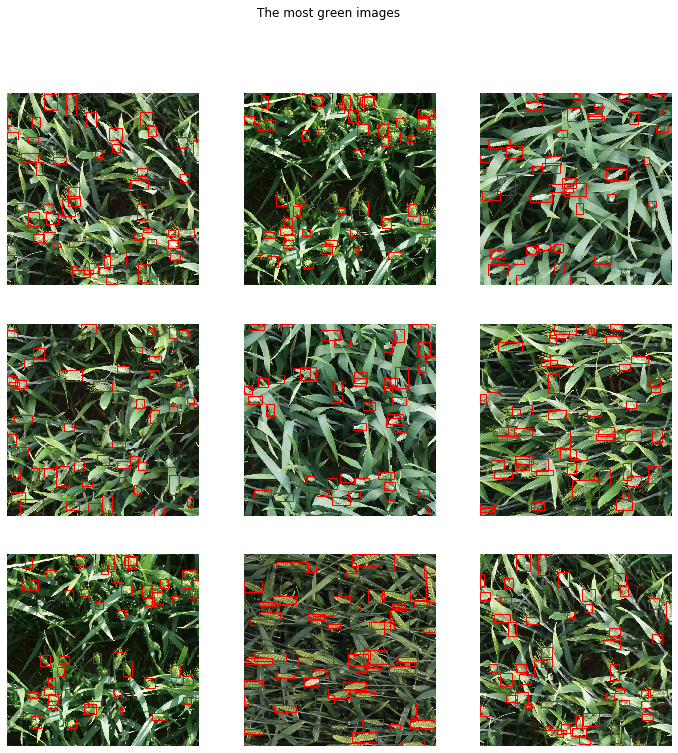

In [104]:
# Plotting images that are mostly green
green_ids = all_train_images[all_train_images['green_pixels'] > 0.55].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(green_ids)],3, title='The most green images')

In [107]:
# add a column with the percentage of yellow pixels
yellow_pixels_df = add_yellow_pixels_percentage(images_df)
all_train_images = all_train_images.merge(yellow_pixels_df, on='image_id')

In [108]:
# Plotting the percentage of yellow pixels
fig = go.Figure(data=[go.Histogram(x=all_train_images['yellow_pixels'])])
fig.show()

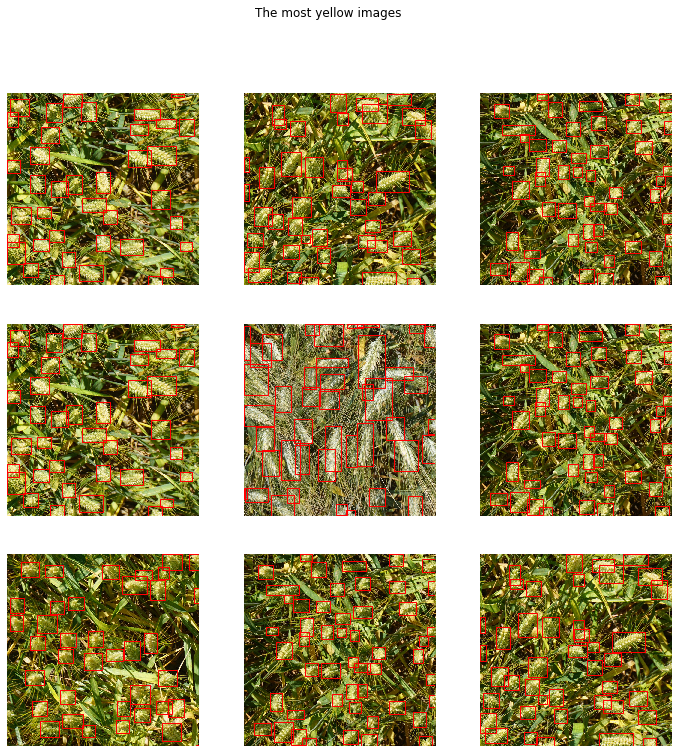

In [110]:
# Plotting images that are mostly green
yellow_ids = all_train_images[all_train_images['yellow_pixels'] > 0.55].image_id
plot_image_examples(all_train_images[all_train_images.image_id.isin(yellow_ids)], 3, title='The most yellow images')

## Summary

Flipping images horizontally and vertically, because the orientation of original images is different;
crop-resize, because we can see spikes at different zoom levels;
different filters to adjust the lighting conditions. I suggest looking at this competition for example.

**What to do with caution:**

Rotation might not work, because rotation messes up the bounding boxes.

Dark images can be brightened, basically can play with colors.
